# Image prediction

## Abstract

The goal of the second notebook was to apply the built models in an application that finds auctions with high-quality tires. Initially, a script was created to find the specified number of tire auctions on the OLX.pl website based on user-provided tire filters (e.g., tire price, tire type, width, profile). Then, for the given number of auctions, Model 2 and Model 3 were implemented. If both models agree that a given image represents good tire quality, the label "good" is assigned to that image; otherwise, it is labeled as "defective". The script then returns links to auctions with at least one image of a good tire. Additionally, a visualization was added, displaying images and the class assigned by the models for each auction.

## Prerequisites

Importing necessary modules.

In [24]:
from selenium import webdriver
from selenium.webdriver.chrome.service import Service
from webdriver_manager.chrome import ChromeDriverManager
from selenium.webdriver.common.by import By
from selenium.webdriver.support.wait import WebDriverWait
from selenium.webdriver.chrome.options import Options
from selenium.webdriver.support import expected_conditions as EC
from bs4 import BeautifulSoup
import requests

import time

import os
from os import mkdir, path, getcwd, listdir
from collections import defaultdict

from PIL import Image
import matplotlib.pyplot as plt

import tensorflow as tf
from keras.models import load_model

## Creating Selenium Script

Defining chome options for Selenium driver.

In [2]:
chrome_options = Options()
chrome_options.add_argument('--lang=en')
chrome_options.add_argument('start-maximized')


### Defining functions

Defining a function to accept necessary cookies on the OLX.pl website.

In [36]:
 # Cookies
    
def cookies_accept():    
    WebDriverWait(driver, 10).until(EC.element_to_be_clickable((By.XPATH,'//*[@id="onetrust-pc-btn-handler"]'))).click()
    WebDriverWait(driver, 10).until(EC.element_to_be_clickable((By.XPATH,'//*[@id="onetrust-pc-sdk"]/div[3]/div[1]/button'))).click()
    

Defining a function allowing the filtering of searched tire auctions on the website. Possible criteria to define:

- tire condition- Condition,
- price- Price,
- type of vehicle for which we are looking for a tire- Vehicle,
- type of tire we are looking for (e.g., summer, winter)- Type,
- tire size in inches- Cale,
- tire width- Szerokosc,
- tire profile- Profil,
- auction sorting (manually defined as from the newest).

In [37]:
# Filtr
def add_filtrs(stan, price_low, price_high, pojazd, typ, cale, szerokosc, profil):
    
    #1 Stan- Wszystkie, Używane, Nowe
    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[4]/div/div/div/div').click()
    driver.find_element(By.XPATH, 
                        f"//p[text()='{stan}']").click()
    
    #2 Cena
    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    price_low_input = driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[5]/div/div[1]/div/div/div/input')
    price_low_input.send_keys(price_low)

    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    price_high_input = driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[5]/div/div[2]/div/div/div/input')
    price_high_input.send_keys(price_high)

    #3 Pojazd- Wszystkie, Osobowe, Dostawcze, Motocykle, Terenowe, Ciężarowe, Pozostałe
    time.sleep(2)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[6]/div/div/div').click()
    driver.find_element(By.XPATH, 
                        f"//p[text()='{pojazd}']").click()

    #4 Typ- Wszystkie, Letnie, Zimowe, Całoroczne, Inny
    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[7]/div/div/div').click()
    driver.find_element(By.XPATH, 
                        f"//p[text()='{typ}']").click()

    #5 Cale- Wszystkie, 12 i mniejsze, 13, 14, 15, 16, 16.5, 17, 17.5, 18, 19, 19.5, 20, 21, 22 i większe
    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[8]/div/div/div').click()
    driver.find_element(By.XPATH, 
                        f"//p[text()='{cale}']").click()

    #6 Szerokość- Wszystkie, 125, 135, 145, 155, 165, 175, 185, 195, 205, 215, 225, 235, 245, 255, 265, 275,
    # 275, 285,295, 305, 315, 325, 335, 30, 31, 32, 33, 35, 37, 5.00, 6.00, 6.40, 6.50, 7.00, 7.50, Inna
    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[9]/div/div/div[1]').click()
    driver.find_element(By.XPATH, 
                        f"//p[text()='{szerokosc}']").click()

    #7 Profil- Wszystkie, 7.00, 9.5, 9.50, 10.5, ...
    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[1]/div/div[10]/div/div/div').click()
    driver.find_element(By.XPATH, 
                        f"//p[text()='{profil}']").click()

    
    #8 Sortuj
    time.sleep(1)
    WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[4]/div/div/div[1]/div/div').click()
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/div[4]/div/div/div[1]/div/div/div[2]/div[2]/div[2]').click()
    ###
    driver.find_element(By.XPATH, 
                        '//*[@id="mainContent"]/div[2]/form/div[3]/h4').click()

Function saving links to the specified number of auctions provided by the user.

In [38]:
def get_links(num_links):
    links_to_offerts = []

    while len(links_to_offerts)<num_links:

        WebDriverWait(driver, 10).until(EC.visibility_of_all_elements_located((By.XPATH,'//*[@id]/a/div/div/div[2]/div[3]')))

        html = driver.page_source
        soup = BeautifulSoup(html)
        for link in soup.find_all("a"):
            links_to_offerts.append(link.get('href'))

        links_to_offerts = [x for x in links_to_offerts if '/d/oferta/' in str(x)]
        #next site
        driver.find_element(By.XPATH,
                           '//*[@id="mainContent"]/div[2]/form/div[5]/div/section[1]/div/ul/a').click()

    links_to_offerts = links_to_offerts[:num_links]   
    links_to_offerts = ["https://www.olx.pl/"+ x for x in links_to_offerts]
    return links_to_offerts



### Launching the Script

Script Retrieving Links to Tire Auctions - The number of auctions and filter criteria have been defined by us.

In [42]:
URL = 'https://www.olx.pl/motoryzacja/opony-felgi/opony/'
driver = webdriver.Chrome(service=Service(ChromeDriverManager().install()), options=chrome_options)

try:
    driver.get(URL)
    
    cookies_accept()
    #driver.implicitly_wait(2)
    add_filtrs("Używane", "10", "300", "Osobowe", "Zimowe", "15", "195", "65")
    links = get_links(40)

finally:
    if driver:
        driver.quit()

### Fetching Images from Auctions

Code for downloading images to the local disk based on previously fetched links and saving them in folders, the names of which were defined as auction links.

In [46]:
def get_images(links):

    # get links to image from auctions
    data_images = defaultdict(list)
    for link in links:
        req = requests.get(link)
        soup = BeautifulSoup(req.content, 'html.parser')
        
        for photo_img in soup.find_all("img"):
            photo_url = photo_img.get("src")
            if "https://ireland" in photo_url:
                data_images[link].append(photo_url)
                
    # download images 
    image_path = os.path.join(os.getcwd(), "images")
    im_num=1
    for auction in data_images:
        for photo_link in data_images[auction]:            
            auction_path = (os.path.join(image_path,auction[29:]))
            if not path.isdir(auction_path):
                mkdir(auction_path)
                
            response = requests.get(photo_link)
            with open(auction_path+f"\image_{im_num}.jpg", "wb") as f:
                f.write(response.content)
            im_num+=1
            
get_images(links)

## Classification of fetched images

At the beginning, Model 2 and Model 3 (models selected in the CNN_1-model_selection notebook) were loaded. Then, a script was created that analyzes each auction. Only links that contained at least one image representing a high-quality tire were displayed. An image of a tire was classified as high-quality only if both models assigned it to the 'good' class. Otherwise, the label 'defective' was assigned.

In [78]:
bestModel2 = load_model(os.path.join(os.getcwd(), "model_save/model_2_manual"))

In [79]:
bestModel3 = load_model(os.path.join(os.getcwd(), "model_save/model_3_manual"))

In [80]:
def load_image(image_path, normalization):  
    img_shape = (224, 224)  

    image = Image.open(image_path)
    image = image.resize((img_shape[0], img_shape[1]))

    image_array = np.asarray(image)
    
    if normalization:
        image_array = image_array / 255.0  
    image_array = image_array.reshape(1, img_shape[0], img_shape[1], 3)  

    return image_array

The following code returns links to auctions containing at least one image of good-quality tires and provides information on how many images depict good-quality tires.

In [82]:
image_path = os.path.join(os.getcwd(), "images")

for dir_auc in listdir(image_path): 
    img_list = os.path.join(image_path, dir_auc)
    
    is_good = []
    for image in listdir(img_list):        
        img_2 = load_image(os.path.join(img_list, image), normalization=True)
        pred_class_2 = bestModel2.predict(np.array(img_2), verbose=0).round(0).astype(int)

        img_3 = load_image(os.path.join(img_list, image), normalization=False)
        pred_class_3 = bestModel3.predict(np.array(img_3), verbose=0).round(0).astype(int)
        
        is_good.append(min(pred_class_2, pred_class_3))

    if np.sum(is_good)>0:
        print(f"Link: olx.pl/d/oferta/{dir_auc}") 
        print(f"Number of good: {np.sum(is_good)}/{len(is_good)}") 
        print(3* "=============================")    
    plt.show()

Link: olx.pl/d/oferta/195-65-15-bridgestone-para-zima-8mm-18r-CID5-IDXj7RX.html
Number of good: 4/4
Link: olx.pl/d/oferta/195-65-15-good-year-para-zima-7-5mm-CID5-IDXj8Y5.html
Number of good: 3/4
Link: olx.pl/d/oferta/195-65-15-michelin-zimowe-7mm-mozliwosc-montazu-poznan-CID5-IDM4t1R.html
Number of good: 3/4
Link: olx.pl/d/oferta/195-65-15-pirelli-CID5-IDVv3TB.html
Number of good: 3/4
Link: olx.pl/d/oferta/1x-zima-195-65-15-pirelli-snowcontrol-195-65r15-CID5-IDNmTet.html
Number of good: 3/3
Link: olx.pl/d/oferta/2x-195-65r15-debica-frigo-opony-zimowe-CID5-IDVvXZt.html
Number of good: 6/6
Link: olx.pl/d/oferta/4-opony-zimowe-debica-195-65-15-11-rok-5mm-CID5-IDVUT8x.html
Number of good: 3/5
Link: olx.pl/d/oferta/4x-zimowe-barum-polaris-3-z-felgami-CID5-IDVVYvb.html
Number of good: 5/6
Link: olx.pl/d/oferta/debica-frigo-hp2-195-65r15-CID5-IDXj7DZ.html
Number of good: 4/4
Link: olx.pl/d/oferta/felgi-stalowe-15-bmw-3-rozstaw-5x120-mm-z-kolpakami-jak-nowe-CID5-IDMRhwx.html
Number of good: 2

The following code analyzes each auction. It returns links to auctions along with tire images and the category assigned by the models.

Link: olx.pl/d/oferta/195-65-15-bridgestone-para-zima-8mm-18r-CID5-IDXj7RX.html


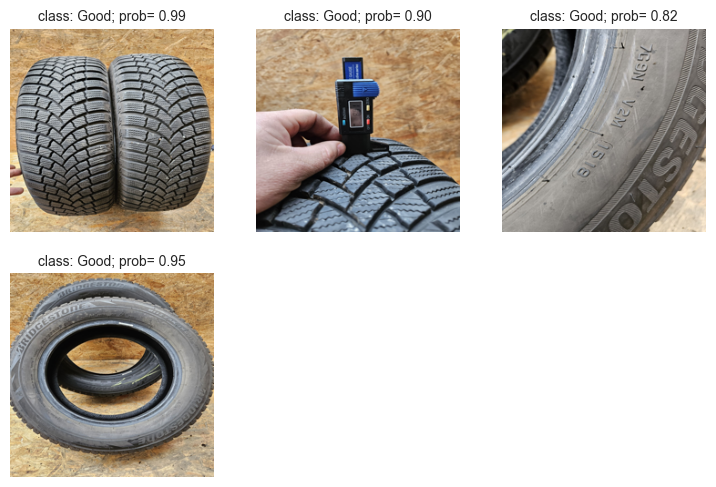

Link: olx.pl/d/oferta/195-65-15-good-year-para-zima-7-5mm-CID5-IDXj8Y5.html


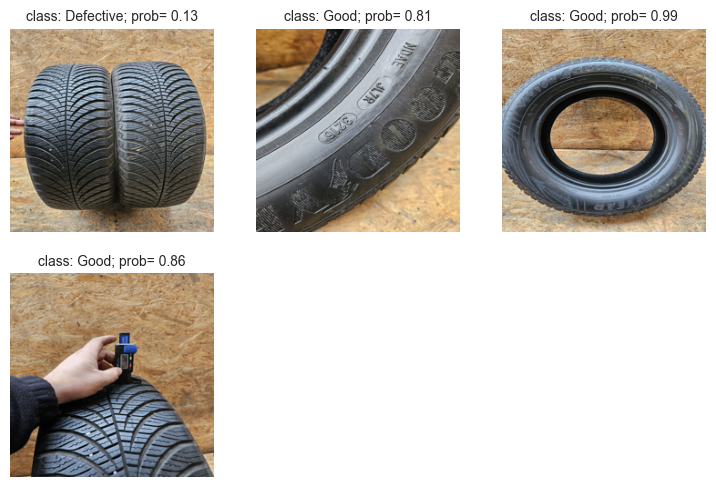

Link: olx.pl/d/oferta/195-65-15-michelin-zimowe-7mm-mozliwosc-montazu-poznan-CID5-IDM4t1R.html


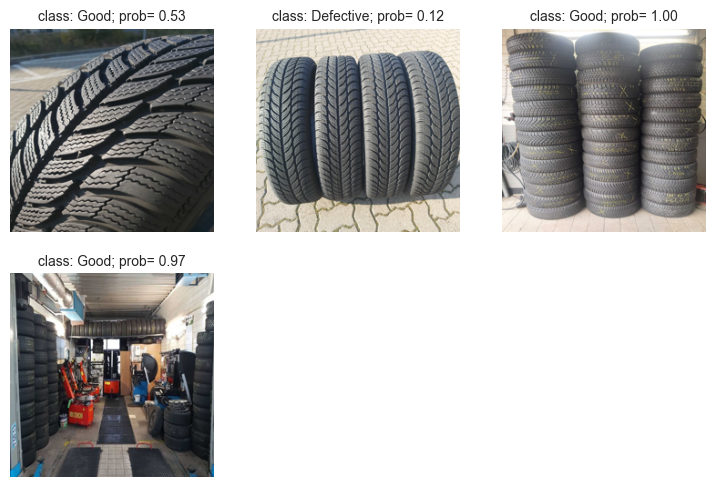

Link: olx.pl/d/oferta/195-65-15-pirelli-CID5-IDVv3TB.html


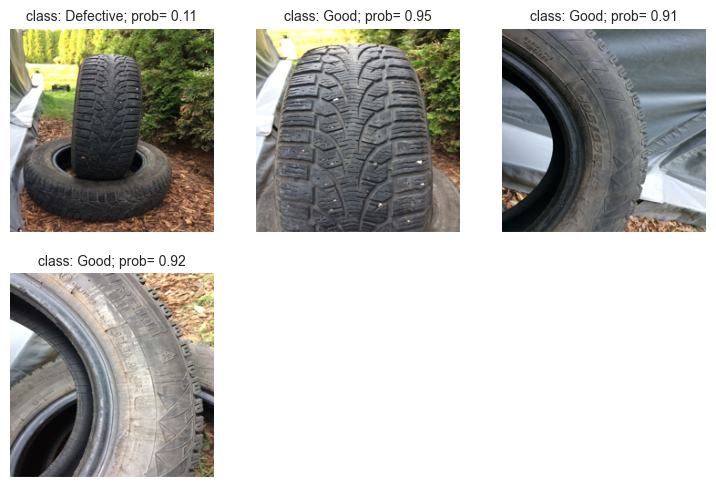

Link: olx.pl/d/oferta/1szt-195-65-15-91t-fulda-kristall-montero-3-5-5mm-2018r-7317-CID5-IDWD8u6.html


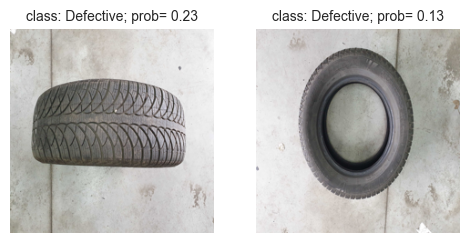

Link: olx.pl/d/oferta/1x-zima-195-65-15-pirelli-snowcontrol-195-65r15-CID5-IDNmTet.html


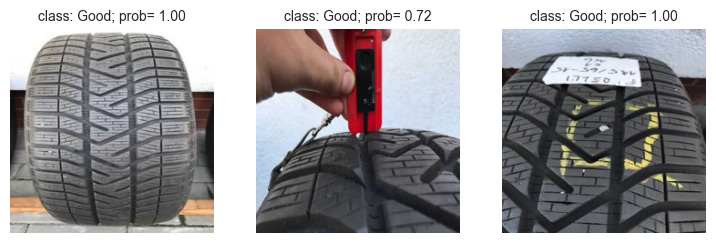

Link: olx.pl/d/oferta/2x-195-65r15-debica-frigo-opony-zimowe-CID5-IDVvXZt.html


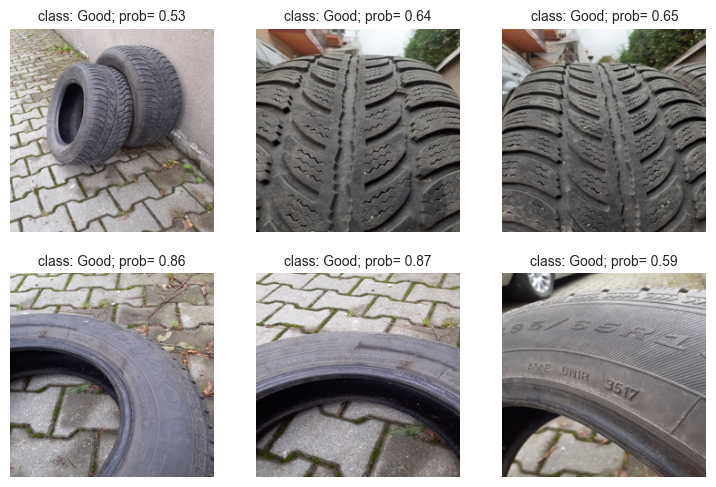

Link: olx.pl/d/oferta/4-opony-zimowe-debica-195-65-15-11-rok-5mm-CID5-IDVUT8x.html


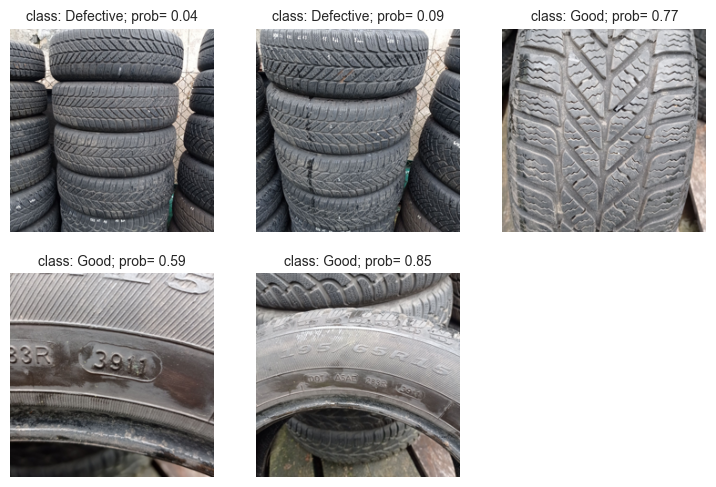

Link: olx.pl/d/oferta/4-opony-zimowe-r15-CID5-IDXj7eX.html


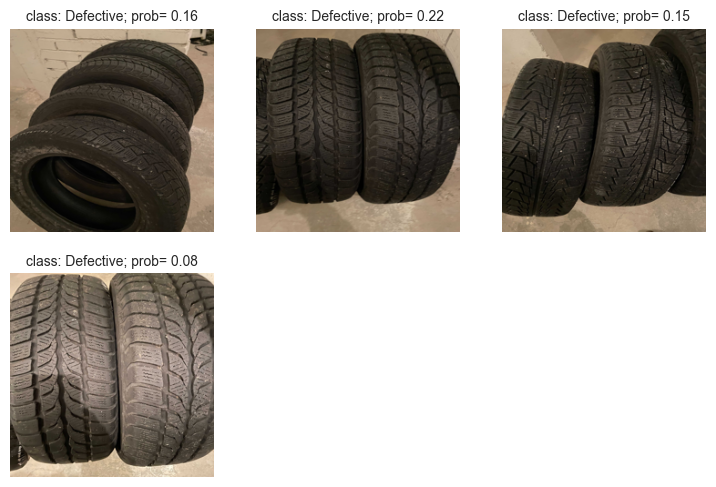

Link: olx.pl/d/oferta/4x-zimowe-barum-polaris-3-z-felgami-CID5-IDVVYvb.html


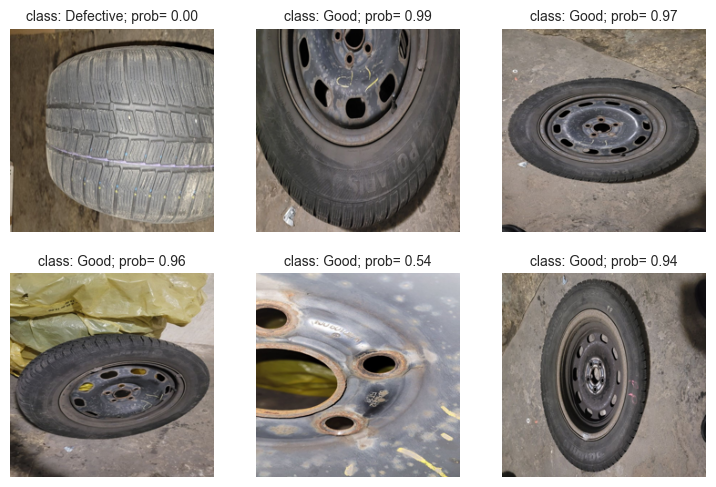

Link: olx.pl/d/oferta/debica-frigo-hp2-195-65r15-CID5-IDXj7DZ.html


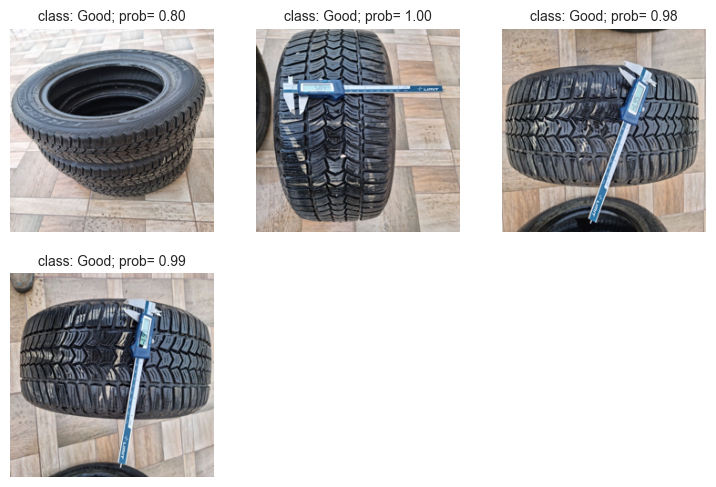

Link: olx.pl/d/oferta/felgi-stalowe-15-bmw-3-rozstaw-5x120-mm-z-kolpakami-jak-nowe-CID5-IDMRhwx.html


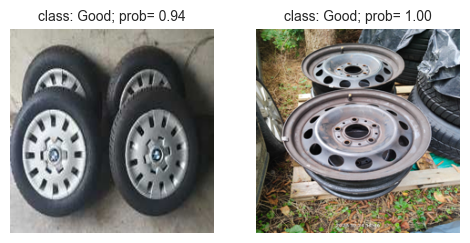

Link: olx.pl/d/oferta/firestone-winterhawk-3-opona-zimowe-195-65r15-CID5-IDT22yp.html


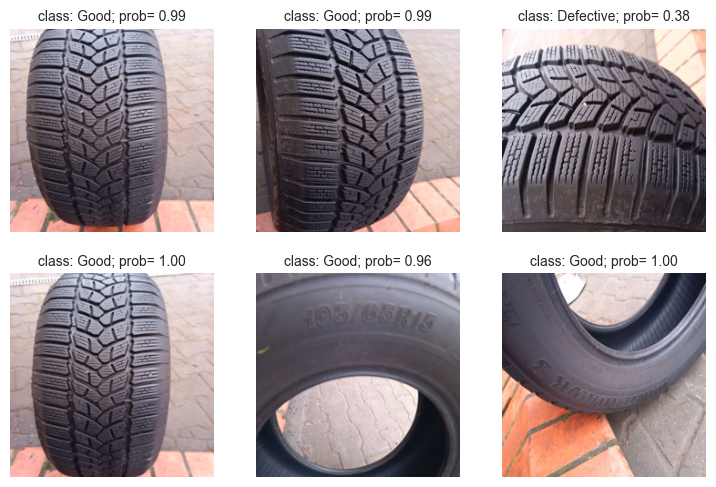

Link: olx.pl/d/oferta/idealne-7-5mm-cena-za-4szt-dunlop-wintersport-195-65-15-CID5-IDXiO6Z.html


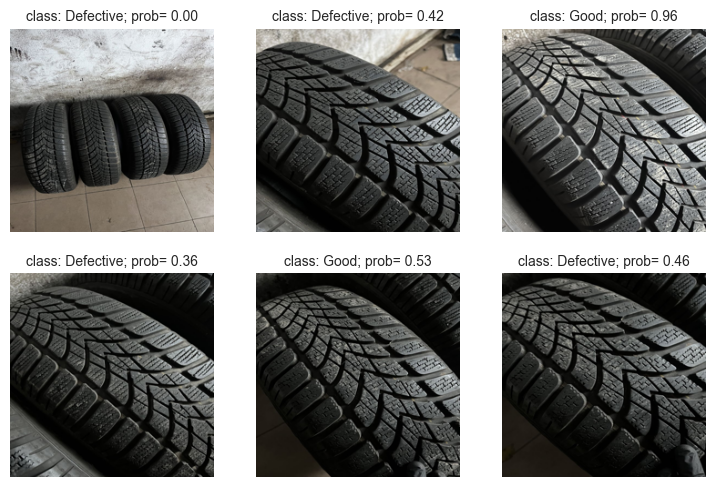

Link: olx.pl/d/oferta/komplet-opon-zimowych-195-65r15-continental-fulda-czestochowa-CID5-IDXjb5h.html


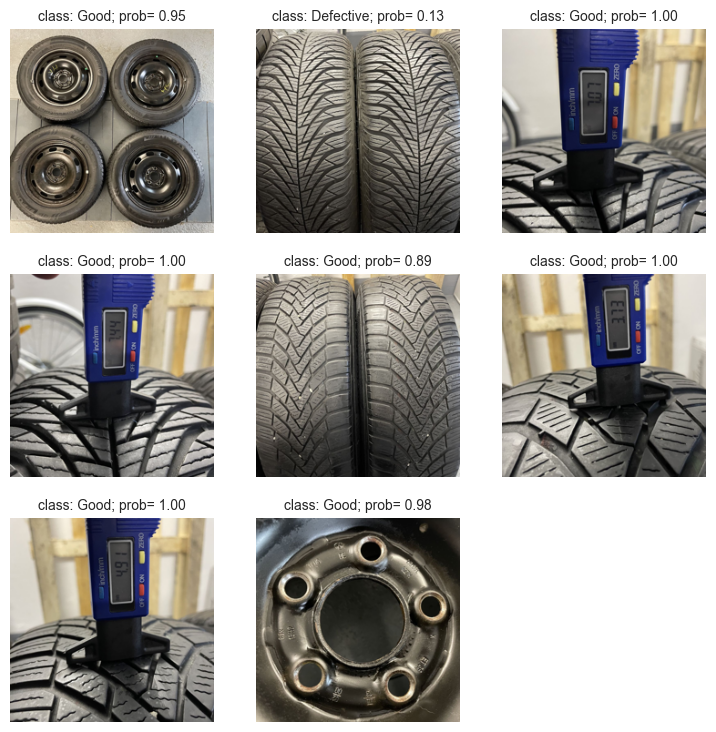

Link: olx.pl/d/oferta/opona-zimowa-kumho-195-65r15-CID5-IDSBdZL.html


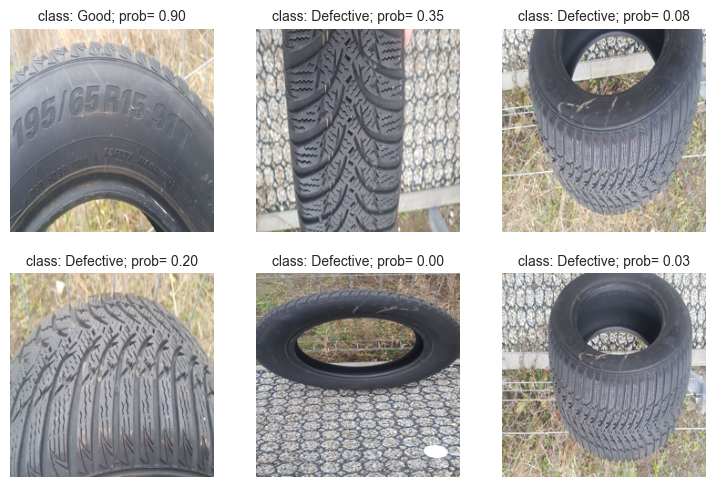

Link: olx.pl/d/oferta/opony-195-65-r15-CID5-IDX1Had.html


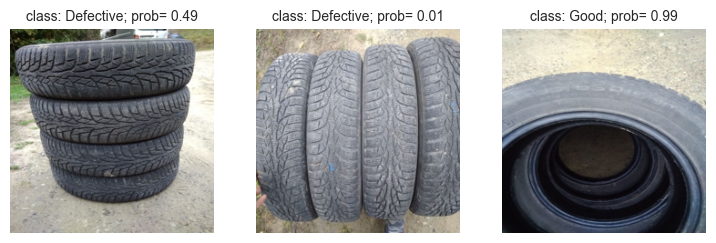

Link: olx.pl/d/oferta/opony-uzywane-wulkanizacja-topczewski-team-CID5-IDd7Jpt.html


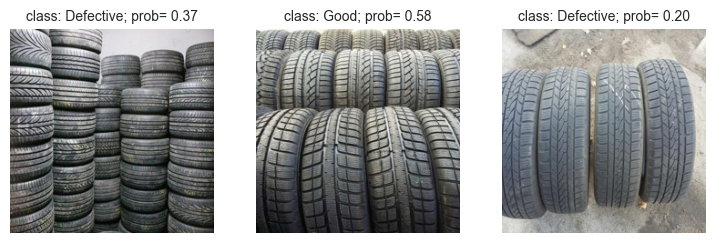

Link: olx.pl/d/oferta/opony-wielosezonowe-2szt-195-65-15-8-3mm-warto-montaz-CID5-IDQPhji.html


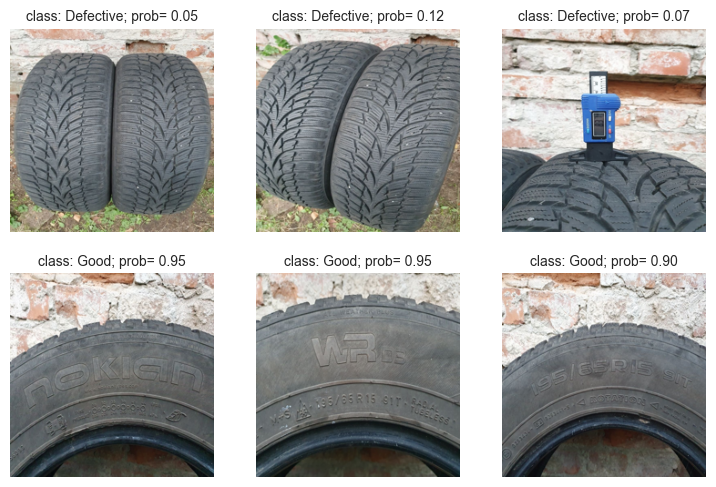

Link: olx.pl/d/oferta/opony-zima-firestone-CID5-IDXcsr2.html


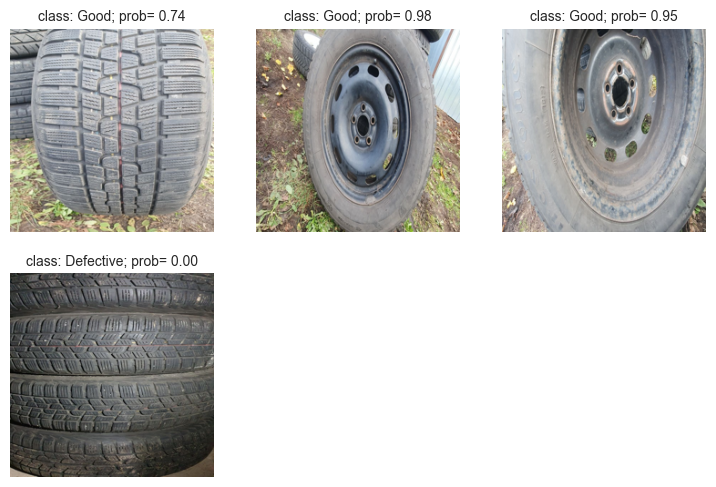

Link: olx.pl/d/oferta/opony-zimowe-15-bieznikowane-markgum-mk790-zima-195-65-r15-bdb-stan-CID5-IDKnJYd.html


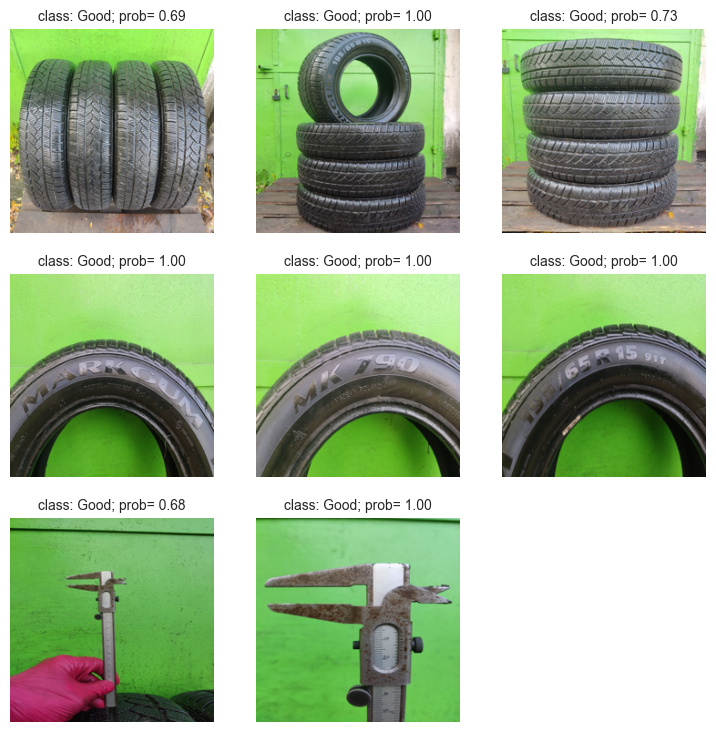

Link: olx.pl/d/oferta/opony-zimowe-15-CID5-IDXjakk.html


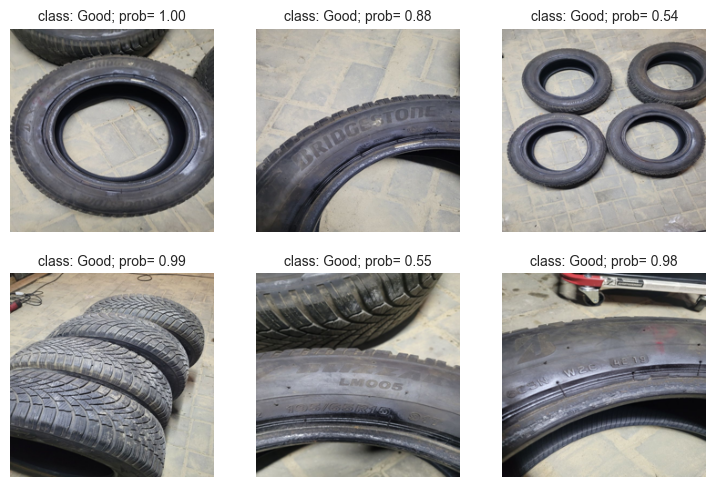

Link: olx.pl/d/oferta/opony-zimowe-195-60-r-16-nokian-CID5-IDIhJIS.html


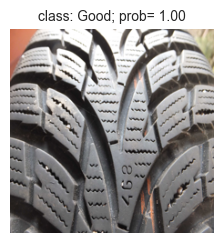

Link: olx.pl/d/oferta/opony-zimowe-195-65-15-215-55-17-CID5-IDXiVsO.html


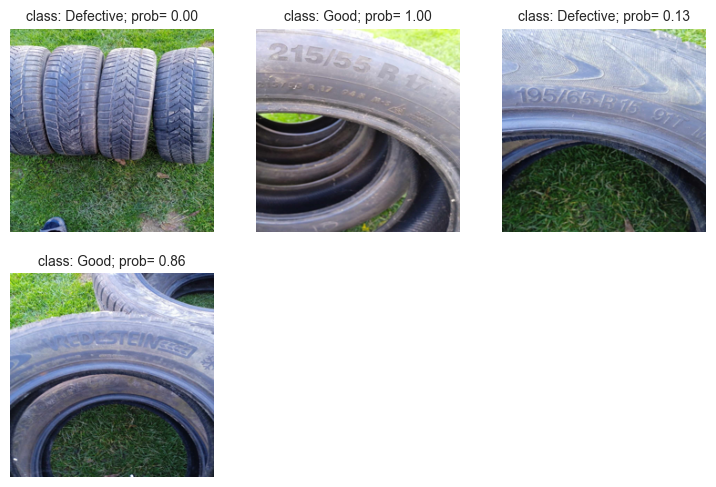

Link: olx.pl/d/oferta/opony-zimowe-195-65-r-15-CID5-IDXfcpJ.html


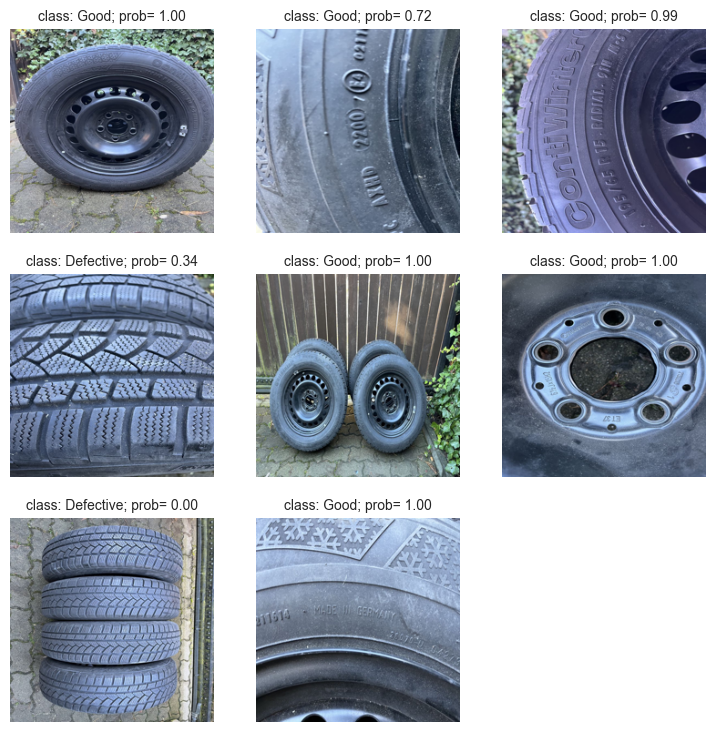

Link: olx.pl/d/oferta/opony-zimowe-195-65-r15-dunlop-wintersport-5-CID5-IDX5iro.html


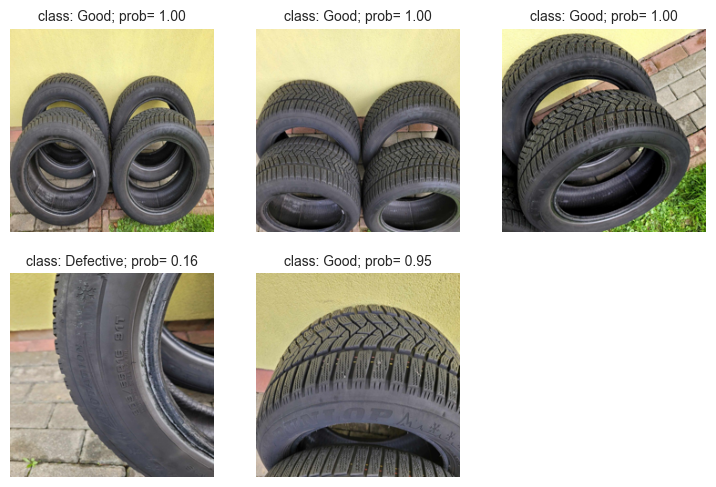

Link: olx.pl/d/oferta/opony-zimowe-continentale-205-65-r-16-c-oraz-195-65-r-15-t-CID5-IDXazQY.html


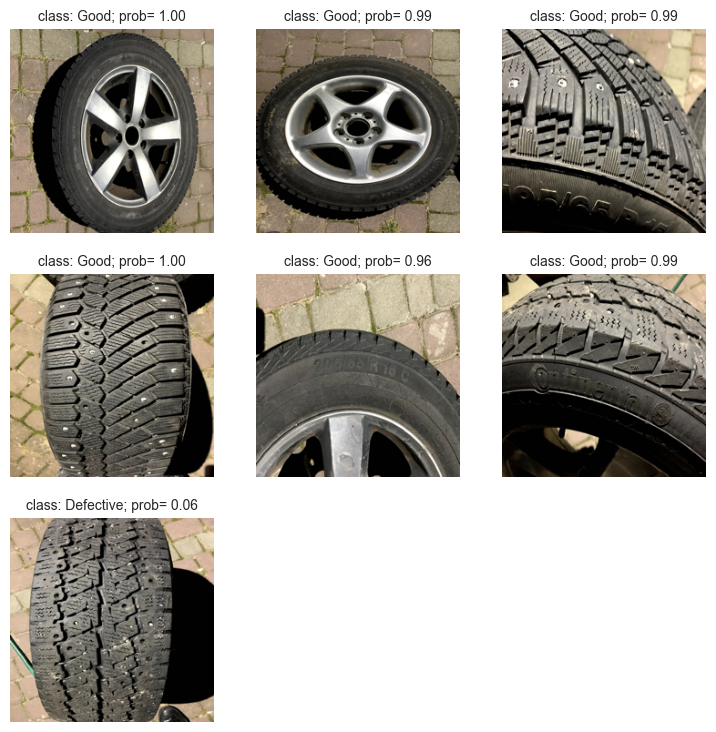

Link: olx.pl/d/oferta/opony-zimowe-debica-frigo-195-65-r15-CID5-IDXbCiD.html


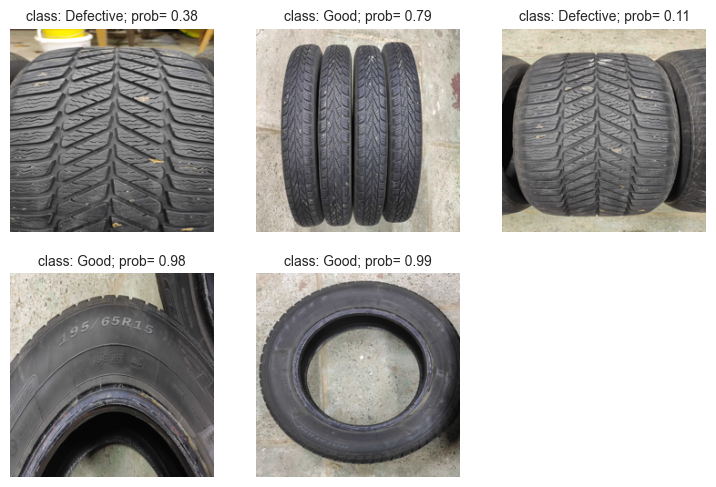

Link: olx.pl/d/oferta/opony-zimowe-do-jazdy-miejskiej-195-65r15-odbior-osobisty-biala-podl-CID5-IDVV61N.html


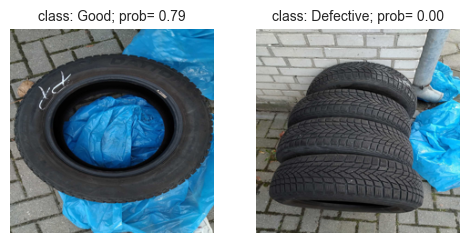

Link: olx.pl/d/oferta/opony-zimowe-firestone-winterhawk-195-65-r15-CID5-IDWPQCz.html


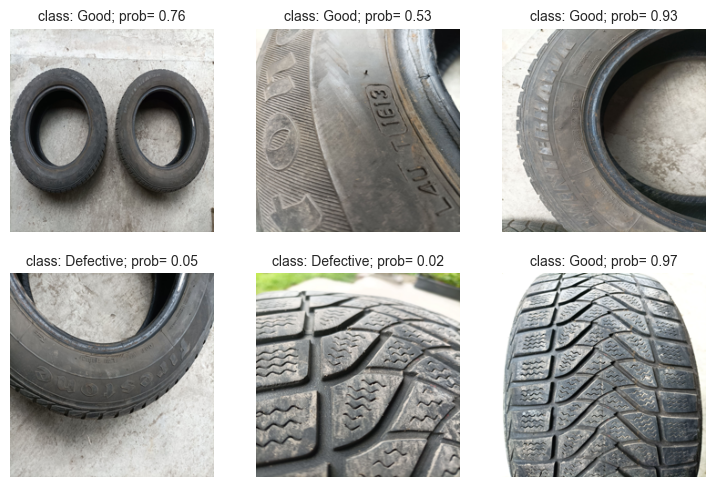

Link: olx.pl/d/oferta/opony-zimowe-goodyear-196-65-r15-CID5-IDXj9R4.html


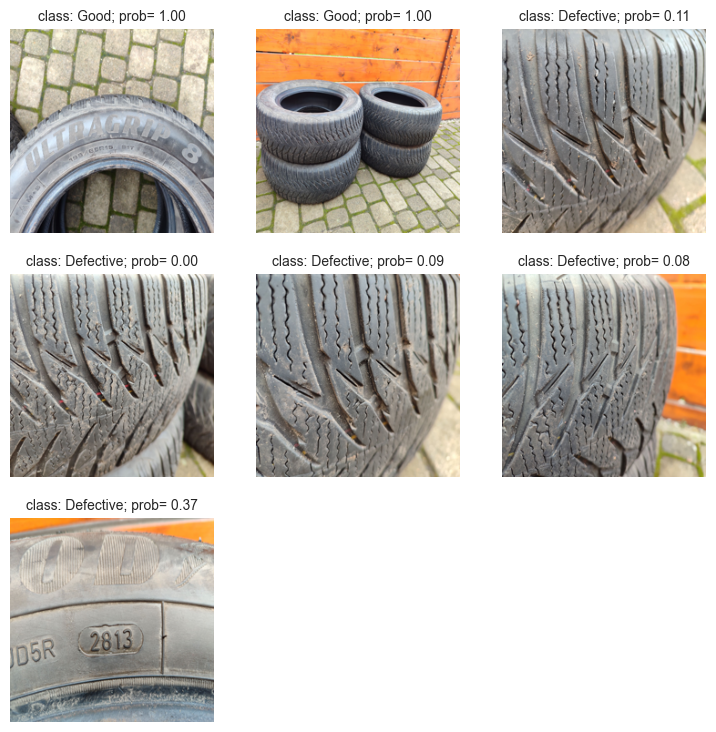

Link: olx.pl/d/oferta/opony-zimowe-kelly-winter-st-195-65-r15-199-zl-komplet-199-zl-CID5-IDXhiyg.html


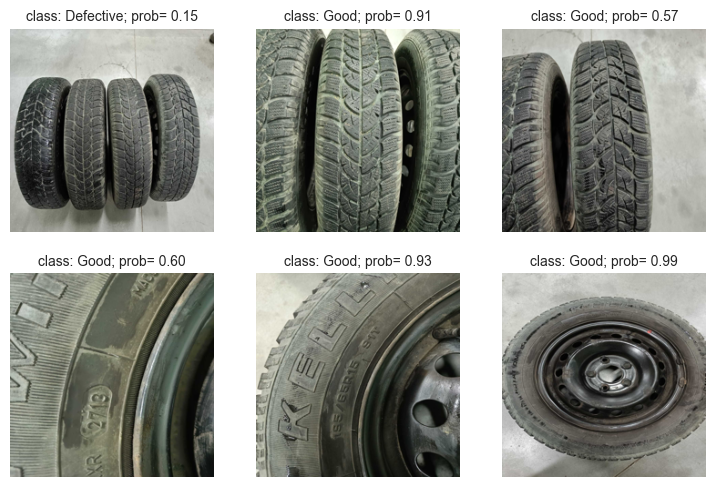

Link: olx.pl/d/oferta/opony-zimowe-matador-195-65r15-uzywane-4-szt-CID5-IDXjdme.html


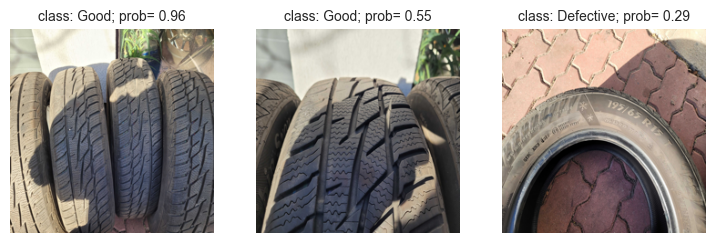

Link: olx.pl/d/oferta/opony-zimowe-nalewki-195-65-r-15-CID5-IDO1gf6.html


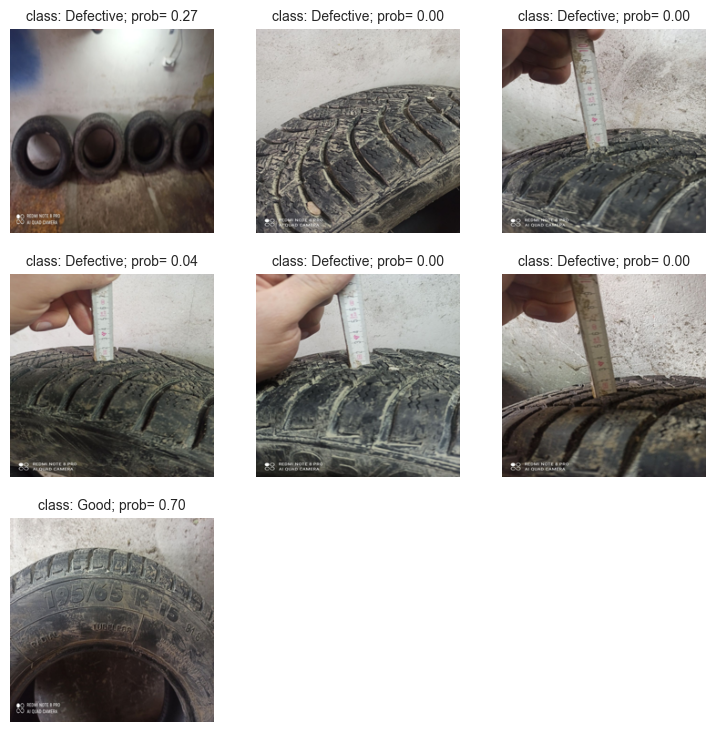

Link: olx.pl/d/oferta/opony-zimowe-sava-195-65r15-felgi-et35-CID5-IDVxFml.html


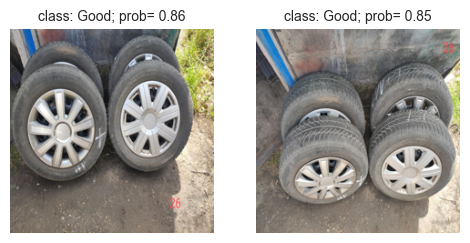

Link: olx.pl/d/oferta/sprzedam-opony-zimowe-15-185-65-15-185-65-14-165-65-CID5-IDO5jrl.html


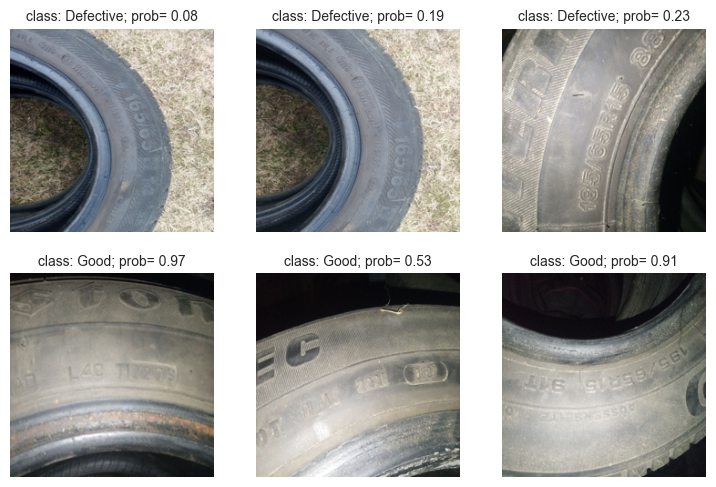

Link: olx.pl/d/oferta/uzywane-195-65r15-zimowe-z-gwarancja-plock-opondex-195-65-15-CID5-IDWAjO9.html


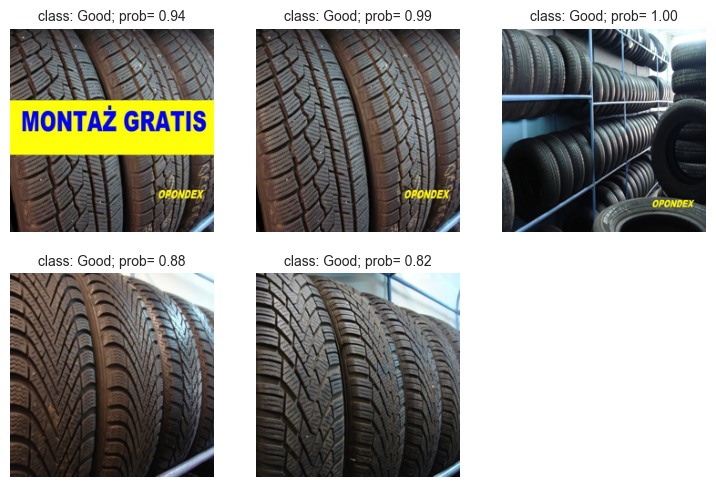

Link: olx.pl/d/oferta/zimowy-opony-195-65-15-CID5-IDXj2Eb.html


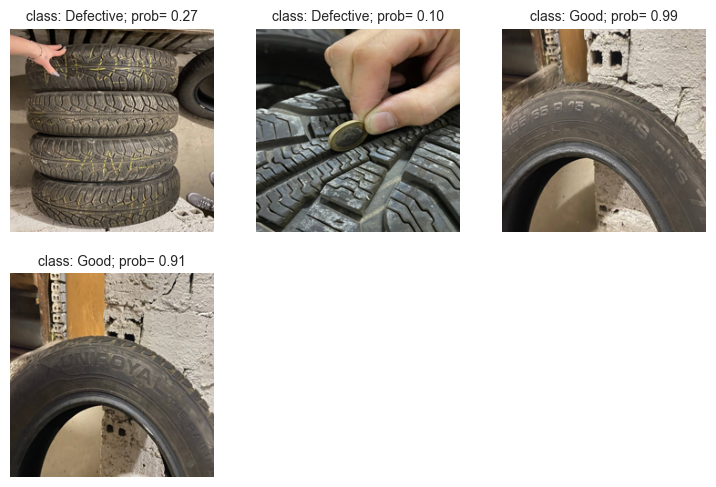

In [86]:
image_path = os.path.join(os.getcwd(), "images")

for dir_auc in listdir(image_path):
    print(f"Link: olx.pl/d/oferta/{dir_auc}")    
    img_list = os.path.join(image_path, dir_auc)
    plt.figure(figsize=(9, 9))
    
    i=0
    for image in listdir(img_list):  
        
        img_2 = load_image(os.path.join(img_list, image), normalization=True)
        img_3 = load_image(os.path.join(img_list, image), normalization=False)
       
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(img_3[0])
        pred_prob_2 = bestModel2.predict(np.array(img_2), verbose=0)[0][0]
        pred_prob_3 = bestModel3.predict(np.array(img_3), verbose=0)[0][0]
        pred_prob = min(pred_prob_2, pred_prob_3)
            
        pred_class = "Good" if pred_prob.round(0) else "Defective"
        
        plt.title(f"class: {pred_class}; prob= {pred_prob:.2f}", fontsize=10)
        plt.axis("off")         
        i+=1
    plt.show() 
    print(3* "=============================")    


## Summary

The final result turned out quite well. It was possible to build two models that achieved F-1 scores of 90% and 96% (VGG19, ResNet50). The custom architecture also showed a good result (F-1 at 84%), but since it was still inferior compared to the other models, the decision was made not to consider the model in further analyses.

It was also possible to use the models to solve a real-world problem (or simply facilitate auction filtering). A script was built to analyze the user-specified number of auctions featuring tires and then, using the constructed models, filter only the auctions with high-quality tires.

To expand the project, several topics can be considered:
- finding/creating a larger dataset with better class assignments,
- expanding the data preparation phase - performing additional transformations on training data (e.g., highlighting features sought by the model) or, during prediction, removing objects from images other than tires,
- improving the Selenium script - securing the script against undesired behaviors (e.g., potential problem that can occur when the number of offers on the website is fewer than the one specified by the user or handling errors on the website),
- checking different network architectures or hyperparameter of existing models.